## Configuracion

In [36]:
# RECUERDEN SUBIR TODAS LAS IMAGENES QUE USARAN EN UNA CARPETA LLAMADA 'Imagenes'.
# El codigo utiliza cameraman por default, pero pueden usar cualquier imagen que les parezca apropiadas.

from scipy import ndimage
from skimage import filters
from skimage import feature
from skimage import util
from skimage import io
from skimage import color

import matplotlib.pyplot as plt
import numpy as np

import os

## Ejemplo de uso de skimage

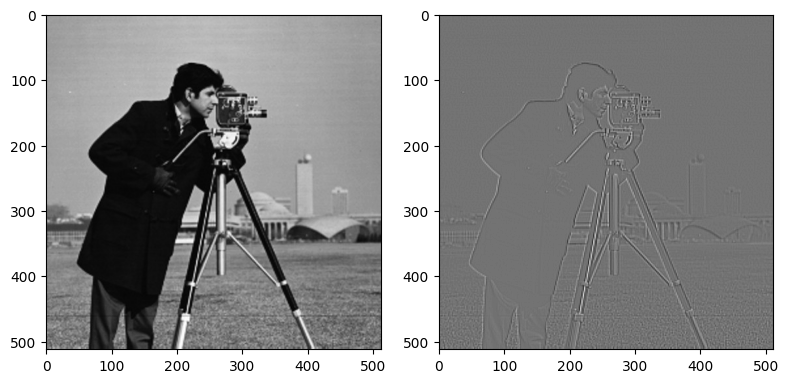

In [37]:
# Indicamos el camino a la imagen
imagenFilename = os.path.join("/content/Imagenes", 'cameraman.jpg')

# Abrimos la imagen indicando que es en escala de gris
imagenPrueba = io.imread(imagenFilename, as_gray=True)

"""
  Creamos nuestro kernel para convolucionar sobre la imagen con numpy.
  Cada array sera una columna de nuestro kernel, por lo que [[-1,2,-3],[-3,7,3],[-4,5,-6]] sera:

                      | -1 -3 -4 |
                      |  2  7  5 |
                      | -3  3 -6 |

  Recordar que en la convolucion se rota el kernel, por lo que se estaria convolucionando con:

                      | -6  3 -3 |
                      |  5  7  2 |
                      | -4 -3 -1 |
 """
kernelPrueba = np.array([[-1,2,-3],[-3,7,3],[-4,5,-6]], dtype=np.int16)

# Para que no causar errores numericos, asegurense que el tipo de dato del kernel y la imagen coincidan
# En este caso usaremos int de 16 bits con signo porque los numeros del kernel son chicos.
# Y el resultado de la convolucion no deberia pasarse de [-32,767, 32,767]
# Si se pasara habria overflow y la imagen apareceria muy ruidosa
imagenPruebaInt16 = imagenPrueba.astype(np.int16)

#Realizamos la convolucion
imagenConvolucionada = ndimage.convolve(imagenPruebaInt16, kernelPrueba)

# Normalizamos la imagen y la volvemos a setear en el rango [0,255]. Con el rango acotado volvemos a convertirlo en uint8
maximoValor = np.max(imagenConvolucionada)
minimoValor = np.min(imagenConvolucionada)
imagenConvolucionadaNormalizada = np.trunc(((imagenConvolucionada - minimoValor) / maximoValor - minimoValor) * 255).astype(np.uint8)

# Mostramos el resultado final
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
ax = axes.ravel()

# Usamos imshow para graficar imagenes, utilizando el cmap plt.cm.gray para especificar que esta en escala de grises
ax[0].imshow(imagenPrueba, cmap=plt.cm.gray)
ax[1].imshow(imagenConvolucionada, cmap=plt.cm.gray)

fig.tight_layout()
plt.show()


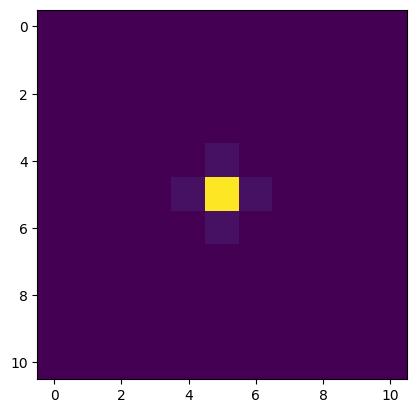

In [38]:
# Aplicacion de una mascara gausseana utilizando skimage
# Pueden ver mas mascaras de skimage en https://scikit-image.org/docs/stable/api/skimage.filters.html
a = np.zeros((11, 11))
a[5, 5] = 1
ejemplo = filters.gaussian(a, sigma=0.4)
plt.imshow(ejemplo)


# **Deteccion de Borde por Metodo de Gradiante**


## **1)** Implemente los operadores de Roberts, Prewitt y Sobel

### Sobel

In [39]:
def Sobel(image, thresholdBorde):
  # Pasamos imagen a float32 (pasando a int16 no nos funciona)
  image = image.astype(np.float32)

  # Definimos los kernels de Sobel (vistos en Teorica)
  sobel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]],dtype=np.int16)
  sobel_y = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]],dtype=np.int16)

  # Aplicamos kernels
  grad_x = ndimage.convolve(image, sobel_x)
  grad_y = ndimage.convolve(image, sobel_y)

  # Calculamos magnitud
  magnitud = np.sqrt(grad_x**2 + grad_y**2)

  # Normalizamos la magnitud y devolvemos a uint8
  maximoValor = np.max(magnitud)
  minimoValor = np.min(magnitud)
  magnitud = np.trunc(((magnitud - minimoValor) / (maximoValor - minimoValor)) * 255).astype(np.uint8)

  # Aplicamos umbral
  magnitud[magnitud < thresholdBorde] = 0
  magnitud[magnitud >= thresholdBorde] = 255
  return magnitud

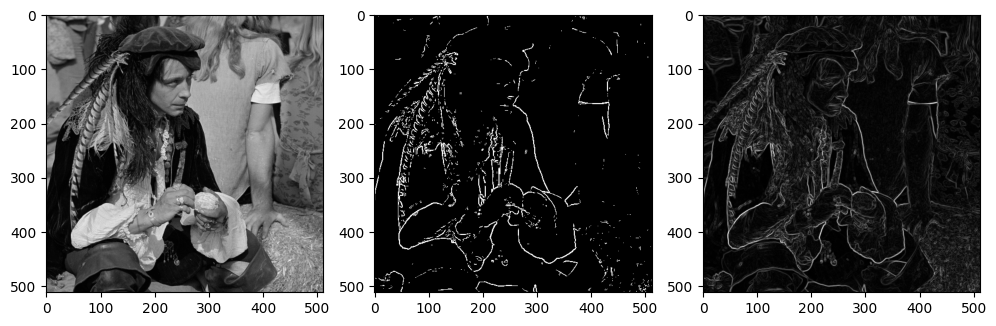

In [40]:
imagenFilename = os.path.join("/content/Imagenes", 'pirate.tif')
imagenPrueba = io.imread(imagenFilename, as_gray=True)

imagenBordes = Sobel(imagenPrueba, 80)
imagenBordesSkiImg = filters.sobel(imagenPrueba)

fig, axes = plt.subplots(1, 3, figsize=(10, 10))

axes[0].imshow(imagenPrueba, cmap=plt.cm.gray)
axes[1].imshow(imagenBordes, cmap=plt.cm.gray)
axes[2].imshow(imagenBordesSkiImg, cmap=plt.cm.gray)

fig.tight_layout()
plt.show()


### Prewitt

In [41]:
def Prewitt(image, thresholdBorde):
  # Pasamos imagen a float32 (pasando a int16 no nos funciona)
  image = image.astype(np.float32)

  # Definimos los kernels de Prewitt (vistos en Teorica)
  prewitt_x = np.array([[-1, 0, 1], [-1, 0 ,1], [-1, 0, 1]],dtype=np.int16)
  prewitt_y = np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]],dtype=np.int16)

  # Aplicamos kernels
  grad_x = ndimage.convolve(image, prewitt_x)
  grad_y = ndimage.convolve(image, prewitt_y)

  # Calculamos magnitud
  magnitud = np.sqrt(grad_x**2 + grad_y**2)

  # Normalizamos la magnitud y devolvemos a uint8
  maximoValor = np.max(magnitud)
  minimoValor = np.min(magnitud)
  magnitud = np.trunc(((magnitud - minimoValor) / (maximoValor - minimoValor)) * 255).astype(np.uint8)

  # Aplicamos umbral
  magnitud[magnitud < thresholdBorde] = 0
  magnitud[magnitud >= thresholdBorde] = 255

  return magnitud

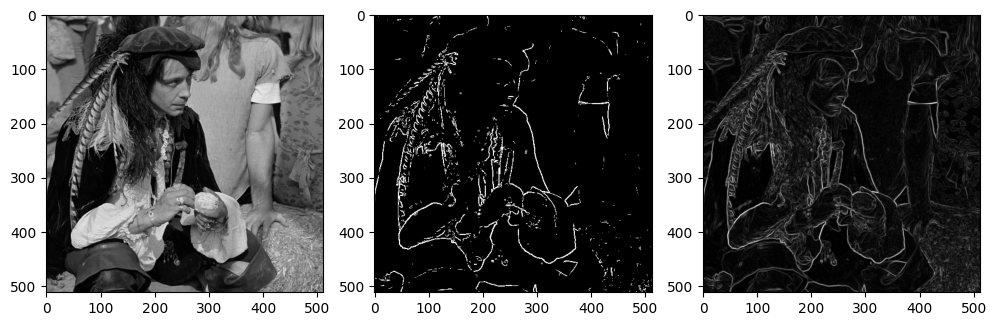

In [42]:
imagenFilename = os.path.join("/content/Imagenes", 'pirate.tif')
imagenPrueba = io.imread(imagenFilename, as_gray=True)

imagenBordes = Prewitt(imagenPrueba, 80)
imagenBordesSkiImg = filters.prewitt(imagenPrueba)

fig, axes = plt.subplots(1, 3, figsize=(10, 10))

axes[0].imshow(imagenPrueba, cmap=plt.cm.gray)
axes[1].imshow(imagenBordes, cmap=plt.cm.gray)
axes[2].imshow(imagenBordesSkiImg, cmap=plt.cm.gray)

fig.tight_layout()
plt.show()

### Roberts

In [43]:
def Roberts(image, thresholdBorde):
  # Pasamos imagen a float32 (pasando a int16 no nos funciona)
  image = image.astype(np.float32)

  # Definimos los kernels de Roberts (vistos en Teorica)
  roberts_x = np.array([[1,0],[0,-1]],dtype=np.int16)
  roberts_y = np.array([[0,1],[-1,0]],dtype=np.int16)

  # Aplicamos kernels
  grad_x = ndimage.convolve(image, roberts_x)
  grad_y = ndimage.convolve(image, roberts_y)

  # Calculamos magnitud
  magnitud = np.sqrt(grad_x**2 + grad_y**2)

  # Normalizamos la magnitud y devolvemos a uint8
  maximoValor = np.max(magnitud)
  minimoValor = np.min(magnitud)
  magnitud = np.trunc(((magnitud - minimoValor) / (maximoValor - minimoValor)) * 255).astype(np.uint8)

  # Aplicamos umbral
  magnitud[magnitud < thresholdBorde] = 0
  magnitud[magnitud >= thresholdBorde] = 255

  return magnitud
  return image

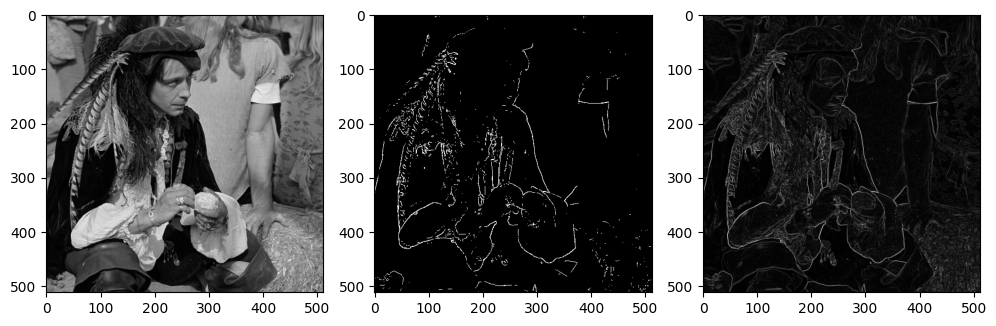

In [44]:
imagenFilename = os.path.join("/content/Imagenes", 'pirate.tif')
imagenPrueba = io.imread(imagenFilename, as_gray=True)

imagenBordes = Roberts(imagenPrueba, 80)
imagenBordesSkiImg = filters.roberts(imagenPrueba)

fig, axes = plt.subplots(1, 3, figsize=(10, 10))

axes[0].imshow(imagenPrueba, cmap=plt.cm.gray)
axes[1].imshow(imagenBordes, cmap=plt.cm.gray)
axes[2].imshow(imagenBordesSkiImg, cmap=plt.cm.gray)

fig.tight_layout()
plt.show()

## **2)** Metodo Laplaciano

Implementen el metodo de deteccion de bordes utilizando el operador Laplaciano con y sin chequeo de la varianza total

In [73]:
# Zero Crossing
def zero_crossing(laplaciano):
    resultado = np.zeros_like(laplaciano)
    filas, cols = laplaciano.shape

    # me quedo con matriz de signos
    signos = np.sign(laplaciano)

    for i in range(1, filas-1):
        for j in range(1, cols-1):
            # Revisar los vecinos para detectar cambios de signo
            vecinos = [signos[i, j+1], signos[i+1, j],
                       signos[i, j-1], signos[i-1, j]]

            # Detectar si hay un cambio de signo entre el pixel y alguno de sus vecinos
            if np.any(np.sign(signos[i,j]) != np.sign(vecinos)):
                resultado[i, j] = 1
            elif laplaciano[i,j] == 0:  # Detectar si el valor es cero
                resultado[i, j] = 1
    return resultado

In [74]:
def LaplacianoSinVarianzaLocal(imagen):
  # Pasamos imagen a float32 (pasando a int16 no nos funciona)
  imagen = imagen.astype(np.float32)

  # Definimos kernel Laplaciano (visto en Teorica)
  laplaciano = np.array([[0,1,0],[1,-4,1],[0,1,0]],dtype=np.float32)

  # Blurreo aplicando filtro gaussiano
  imagen = filters.gaussian(imagen, sigma=1)

  # Aplicamos kernels
  resultado = ndimage.convolve(imagen, laplaciano)

  # Calculamos valor absoluto para detectar bordes
  resultado = np.abs(resultado)

  # Normalizamos la magnitud y devolvemos a uint8

  maximoValor = np.max(resultado)
  minimoValor = np.min(resultado)
  resultado = np.trunc(((resultado - minimoValor) / (maximoValor - minimoValor)) * 255).astype(np.uint8)

  return resultado

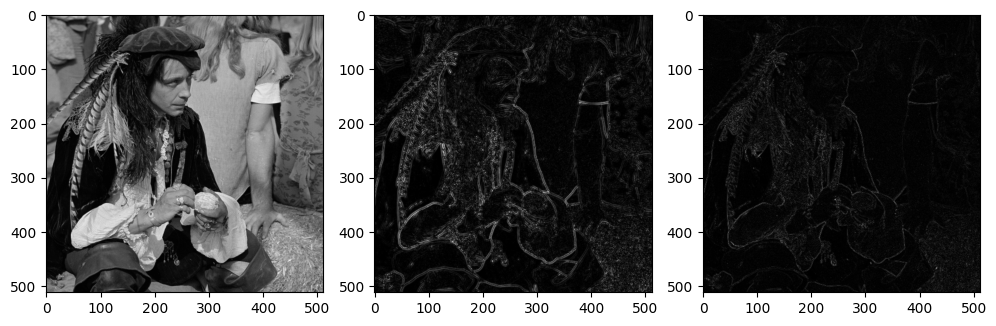

In [47]:
# Probamos como funciona el Laplaciano implementado vs. Laplaciano de SkiImg
imagenFilename = os.path.join("/content/Imagenes", 'pirate.tif')
imagenPrueba = io.imread(imagenFilename, as_gray=True)

imagenBordes = LaplacianoSinVarianzaLocal(imagenPrueba)
imagenBordesSkiImg = np.abs(filters.laplace(imagenPrueba)) # Aplico el absoluto a filters.laplace

fig, axes = plt.subplots(1, 3, figsize=(10, 10))

axes[0].imshow(imagenPrueba, cmap=plt.cm.gray)
axes[1].imshow(imagenBordes, cmap=plt.cm.gray)
axes[2].imshow(imagenBordesSkiImg, cmap=plt.cm.gray)

fig.tight_layout()
plt.show()

Usualmente puede haber artefactos por causa de ruido que aparecen como bordes en la imagen resultante luego del operador Laplaciano, consecuencia de ser muy fragil contra el ruido agregado a la imagen original.

Por esta misma razon agregamos un paso mas a nuestro filtro, al realizar zero crossing tambien chequearemos la varianza local del pixel en la imagen original, ya que un punto de borde deberia encontrarse en posiciones de gran variabilidad.

In [48]:
def LaplacianoConVarianzaLocal(imagen, umbralVar):
  # Pasamos imagen a float32 (pasando a int16 no nos funciona)
  imagen = imagen.astype(np.float32)

  # Definimos kernel Laplaciano (visto en Teorica)
  laplaciano = np.array([[0,1,0],[1,-4,1],[0,1,0]],dtype=np.float32)

  # Blurreo aplicando filtro gaussiano
  imagen = filters.gaussian(imagen, sigma=1)

  # Aplicamos kernels
  resultado = ndimage.convolve(imagen, laplaciano)

  # Realizo zero crossing
  zerocrossing = zero_crossing(resultado)

  # Normalizo el resultado
  resultado = np.abs(resultado)

  # Normalizamos la magnitud y devolvemos a uint8
  maximoValor = np.max(resultado)
  minimoValor = np.min(resultado)
  resultado = np.trunc(((resultado - minimoValor) / (maximoValor - minimoValor)) * 255).astype(np.uint8)

  # Calculo la varianza local en ventana de 3x3 (en imagen)
  varianza_local = ndimage.generic_filter(imagen, np.var, size=3)

  # Filtro solo donde zerocrossing es 1 y la varianza local es mayor al umbral
  for i in range(resultado.shape[0]):
      for j in range(resultado.shape[1]):
        # Si no es zerocrossing o si la varianza local no supera el umbral
          if zerocrossing[i,j] == 0 or varianza_local[i,j] < umbralVar:
            resultado[i,j] = 0 # No es un borde, lo mando al negro

  return resultado

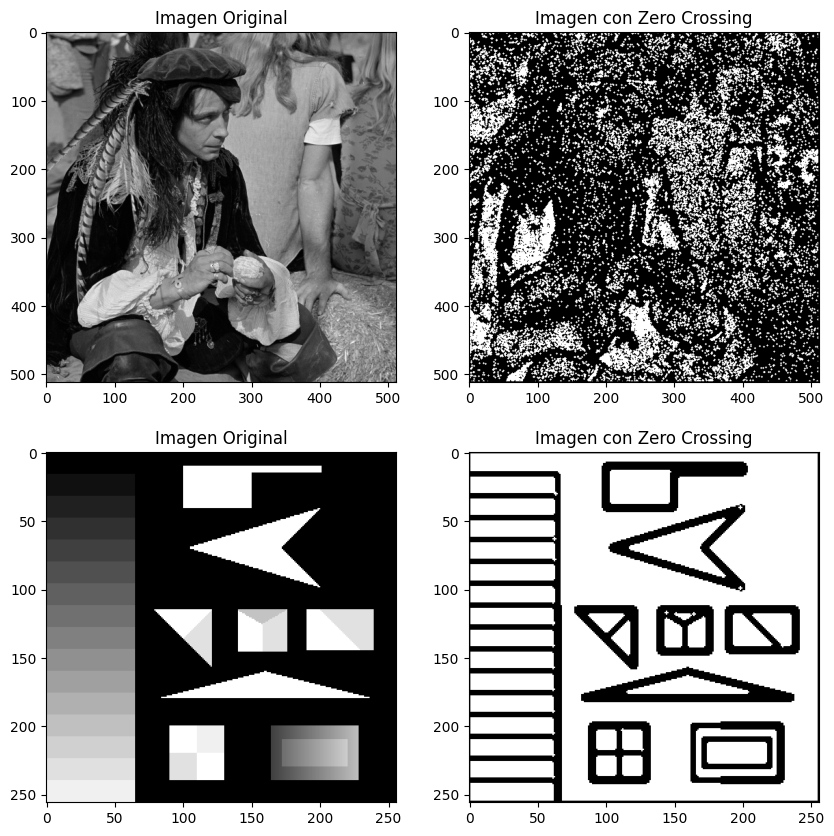

In [75]:
imagenFilename = os.path.join("/content/Imagenes", 'pirate.tif')
imagenPirata = io.imread(imagenFilename, as_gray=True)

imagenFilename = os.path.join("/content/Imagenes", 'test.jpg')
imagenTest = io.imread(imagenFilename, as_gray=True)

laplacianoPirata = LaplacianoSinVarianzaLocal(imagenPirata)
laplacianoTest = LaplacianoSinVarianzaLocal(imagenTest)


# Mostramos imagenes binarias despues de zerocrossing
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

axes[0][0].set_title('Imagen Original')
axes[0][1].set_title('Imagen con Zero Crossing')


axes[0][0].imshow(imagenPirata, cmap=plt.cm.gray)
axes[0][1].imshow(zero_crossing(laplacianoPirata)*256, cmap=plt.cm.gray)

axes[1][0].set_title('Imagen Original')
axes[1][1].set_title('Imagen con Zero Crossing')


axes[1][0].imshow(imagenTest, cmap=plt.cm.gray)
axes[1][1].imshow(zero_crossing(laplacianoTest), cmap=plt.cm.gray)




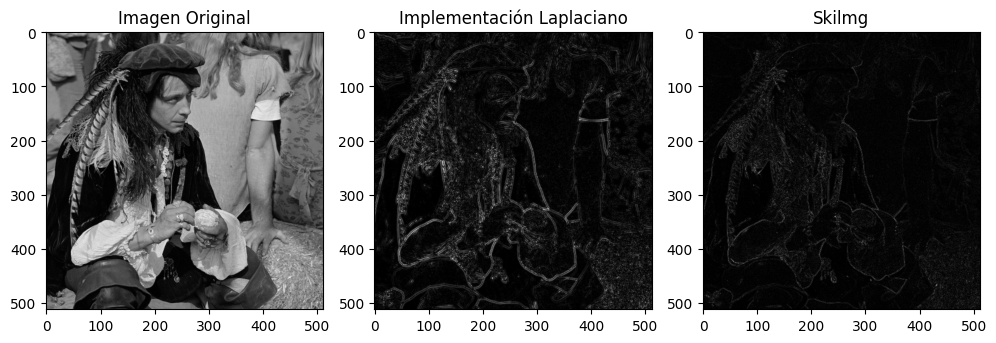

In [76]:
# Probamos como funciona el Laplaciano implementado vs. Laplaciano de SkiImg
imagenFilename = os.path.join("/content/Imagenes", 'pirate.tif')
imagenPrueba = io.imread(imagenFilename, as_gray=True)

imagenBordes_sin_varianza_local = LaplacianoSinVarianzaLocal(imagenPrueba)
imagenBordesSkiImg = np.abs(filters.laplace(imagenPrueba)) # Aplico el absoluto a filters.laplace

fig, axes = plt.subplots(1, 3, figsize=(10, 10))

axes[0].set_title('Imagen Original')
axes[1].set_title('Implementación Laplaciano')
axes[2].set_title('Skilmg')


axes[0].imshow(imagenPrueba, cmap=plt.cm.gray)
axes[1].imshow(imagenBordes_sin_varianza_local, cmap=plt.cm.gray)
axes[2].imshow(imagenBordesSkiImg, cmap=plt.cm.gray)

fig.tight_layout()
plt.show()

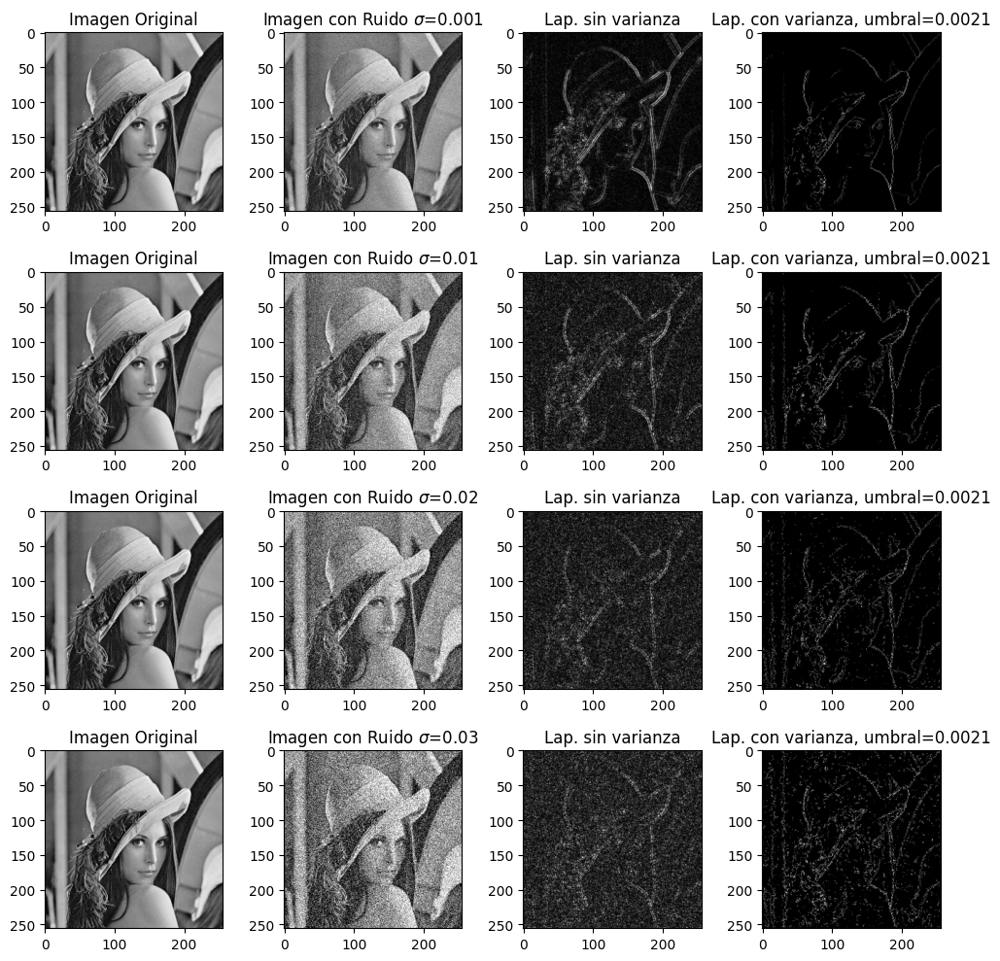

In [77]:
# Aplicamos a versiones contaminadas con Ruido Gaussiano
imagenFilename = os.path.join("/content/Imagenes", 'lena_gray_256.jpg')
imagenPrueba_lena = io.imread(imagenFilename, as_gray=True)

imagenFilename = os.path.join("/content/Imagenes", 'test.jpg')
imagenPrueba_test = io.imread(imagenFilename, as_gray=True)
umbral = 0.0021

fig, axes = plt.subplots(4, 4, figsize=(10, 10))

for (i,sigma) in enumerate([0.001,0.01,0.02,0.03]):
  imagenPrueba_lena_ruido = util.random_noise(imagenPrueba_lena, mode='gaussian', var=sigma)

  axes[i][0].set_title('Imagen Original')
  axes[i][1].set_title(f'Imagen con Ruido $\sigma$={sigma}')
  axes[i][2].set_title('Lap. sin varianza')
  axes[i][3].set_title(f'Lap. con varianza, umbral={umbral}')

  axes[i][0].imshow(imagenPrueba_lena, cmap=plt.cm.gray)
  axes[i][1].imshow(imagenPrueba_lena_ruido, cmap=plt.cm.gray)
  axes[i][2].imshow(LaplacianoSinVarianzaLocal(imagenPrueba_lena_ruido), cmap=plt.cm.gray)
  axes[i][3].imshow(LaplacianoConVarianzaLocal(imagenPrueba_lena_ruido,umbral), cmap=plt.cm.gray)

fig.tight_layout()
plt.show()

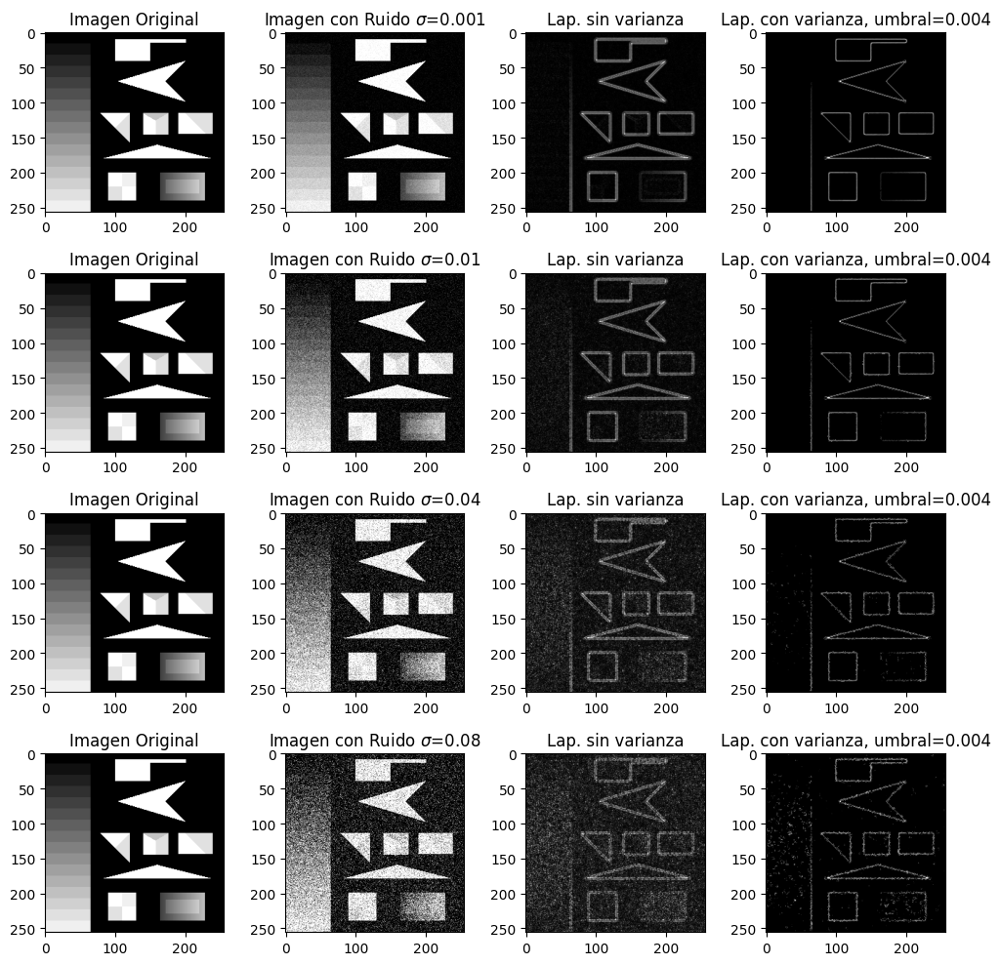

In [78]:
# Aplicamos a versiones contaminadas con Ruido Gaussiano
imagenFilename = os.path.join("/content/Imagenes", 'lena_gray_256.jpg')
imagenPrueba_lena = io.imread(imagenFilename, as_gray=True)

imagenFilename = os.path.join("/content/Imagenes", 'test.jpg')
imagenPrueba_test = io.imread(imagenFilename, as_gray=True)
umbral = 0.004

fig, axes = plt.subplots(4, 4, figsize=(10,10))

for (i,sigma) in enumerate([0.001,0.01,0.04,0.08]):
  imagenPrueba_test_ruido = util.random_noise(imagenPrueba_test, mode='gaussian', var=sigma)

  axes[i][0].set_title('Imagen Original')
  axes[i][1].set_title(f'Imagen con Ruido $\sigma$={sigma}')
  axes[i][2].set_title('Lap. sin varianza')
  axes[i][3].set_title(f'Lap. con varianza, umbral={umbral}')

  axes[i][0].imshow(imagenPrueba_test, cmap=plt.cm.gray)
  axes[i][1].imshow(imagenPrueba_test_ruido, cmap=plt.cm.gray)
  axes[i][2].imshow(LaplacianoSinVarianzaLocal(imagenPrueba_test_ruido), cmap=plt.cm.gray)
  axes[i][3].imshow(LaplacianoConVarianzaLocal(imagenPrueba_test_ruido,umbral), cmap=plt.cm.gray)

fig.tight_layout()
plt.show()

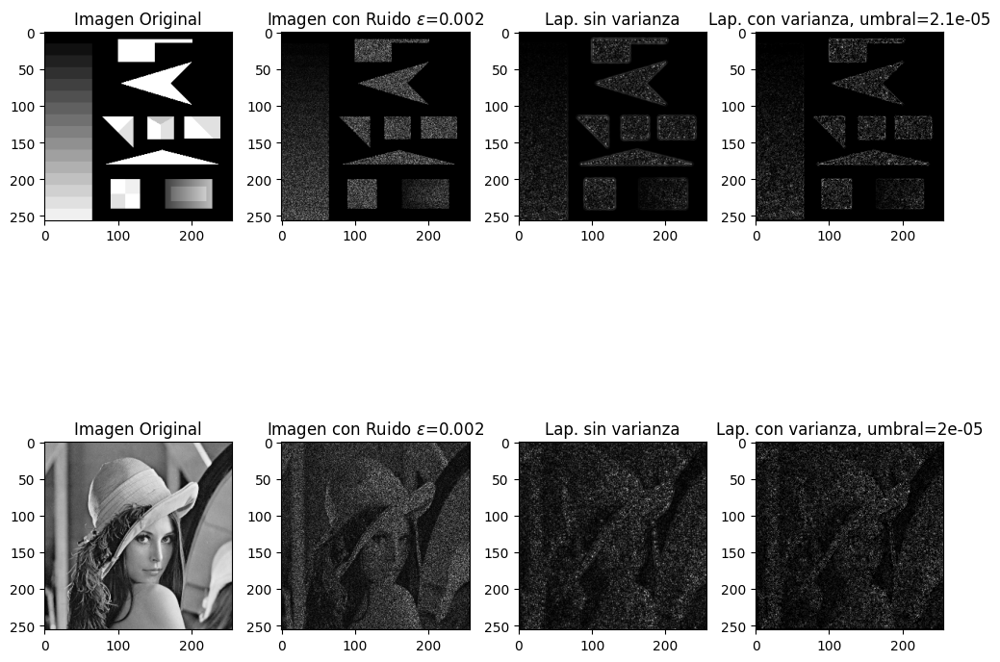

In [79]:
# Aplicamos a versiones contaminadas con Ruido Rayleigh
imagenFilename = os.path.join("/content/Imagenes", 'lena_gray_256.jpg')
imagenPrueba_lena = io.imread(imagenFilename, as_gray=True)

imagenFilename = os.path.join("/content/Imagenes", 'test.jpg')
imagenPrueba_test = io.imread(imagenFilename, as_gray=True)
umbral_test = 0.000021
umbral_lena = 0.00002
epsilon = 0.002

fig, axes = plt.subplots(2, 4, figsize=(10,10))

imagenPrueba_test_ruido = imagenPrueba_test * np.random.rayleigh(epsilon, imagenPrueba_test.shape)
imagenPrueba_lena_ruido = imagenPrueba_lena * np.random.rayleigh(epsilon,imagenPrueba_lena.shape)

axes[0][0].set_title('Imagen Original')
axes[0][1].set_title(f'Imagen con Ruido $\epsilon$={epsilon}')
axes[0][2].set_title('Lap. sin varianza')
axes[0][3].set_title(f'Lap. con varianza, umbral={umbral_test}')

axes[0][0].imshow(imagenPrueba_test, cmap=plt.cm.gray)
axes[0][1].imshow(imagenPrueba_test_ruido, cmap=plt.cm.gray)
axes[0][2].imshow(LaplacianoSinVarianzaLocal(imagenPrueba_test_ruido), cmap=plt.cm.gray)
axes[0][3].imshow(LaplacianoConVarianzaLocal(imagenPrueba_test_ruido,umbral_test), cmap=plt.cm.gray)

axes[1][0].set_title('Imagen Original')
axes[1][1].set_title(f'Imagen con Ruido $\epsilon$={epsilon}')
axes[1][2].set_title('Lap. sin varianza')
axes[1][3].set_title(f'Lap. con varianza, umbral={umbral_lena}')

axes[1][0].imshow(imagenPrueba_lena, cmap=plt.cm.gray)
axes[1][1].imshow(imagenPrueba_lena_ruido, cmap=plt.cm.gray)
axes[1][2].imshow(LaplacianoSinVarianzaLocal(imagenPrueba_lena_ruido), cmap=plt.cm.gray)
axes[1][3].imshow(LaplacianoConVarianzaLocal(imagenPrueba_lena_ruido,umbral_lena), cmap=plt.cm.gray)

fig.tight_layout()
plt.show()

## Ruidos

El ruido es una señal no deseada que se mezcla con una señal útil en cualquier sistema de comunicación o proceso. En procesamiento de imagenes nos enfocaremos pricipalmente en ruido Gausseano y Rayleigh, los dos causados por los sensores utilizados en la obtencion de imagenes y con una funcion de probabilida clara.

### Ruido Gausseano

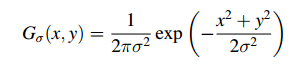

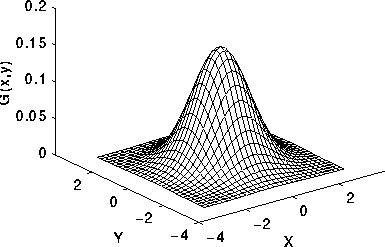

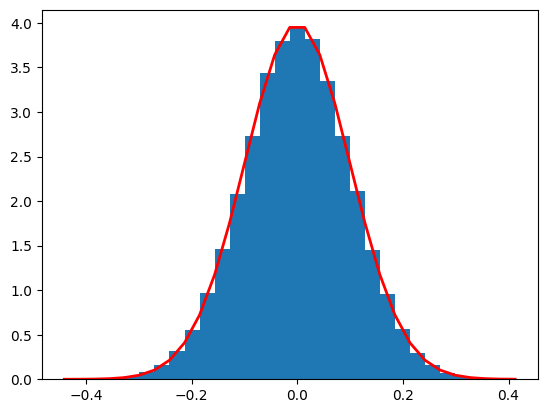

In [54]:
mu, sigma = 0, 0.1
s = np.random.normal(mu, sigma, 100000)

count, bins, ignored = plt.hist(s, 30, density=True)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *
               np.exp( - (bins - mu)**2 / (2 * sigma**2) ),
         linewidth=2, color='r')
plt.show()

### Ruido Rayleigh

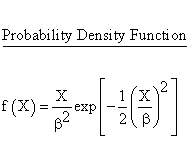


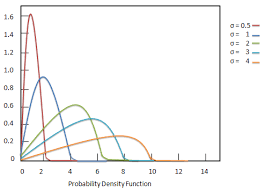

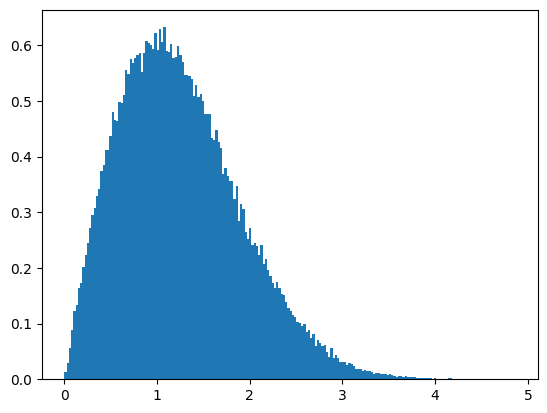

In [55]:
plt.hist(np.random.rayleigh(1, 100000), bins=200, density=True)
plt.show()

## Ruido y el operador Laplaciano

Comparen que sucede con los bordes detectados segun la cantidad y el tipo de ruidos que se encuentra en la imagen. ¿Por que creen que sucenden estos cambios?

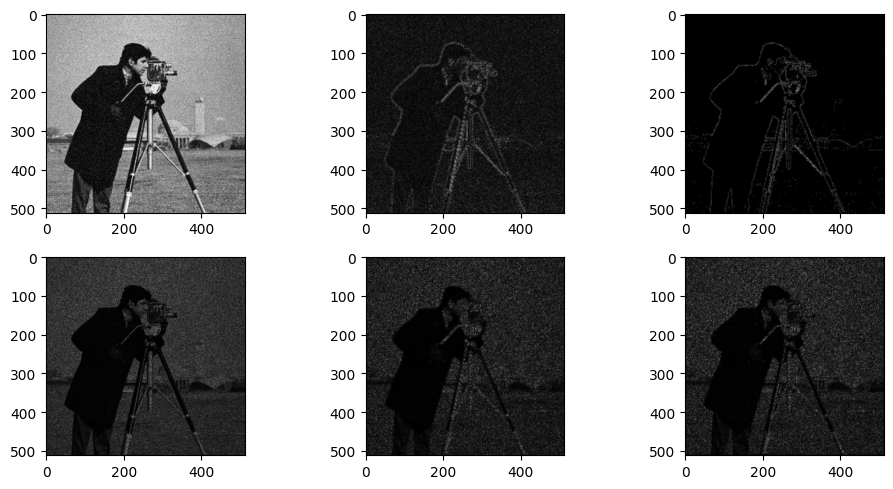

In [56]:
imagenFilename = os.path.join("/content/Imagenes", 'cameraman.jpg')
imagenPrueba = io.imread(imagenFilename, as_gray=True)

# Agregamos ruido Gausseano Aditivo
ImagenConRuidoGausseano = util.random_noise(imagenPrueba, mode='gaussian', mean=0, var=0.01)

#Agregamos ruido Rayleigh Multiplicativo
imagenConRayleigh =  imagenPrueba * np.random.rayleigh(0.2, imagenPrueba.shape)

# Aunque ya no estamos trabajando con imagenes del rango [0,255], nuestros metodos seguiran funcionando
# Ya que todas nuestras tecnicas son generales sobre cualquier señal de 2 dimensiones.

fig, axes = plt.subplots(2, 3, figsize=(10, 5))

axes[0][0].imshow(ImagenConRuidoGausseano, cmap=plt.cm.gray)
axes[0][1].imshow(LaplacianoSinVarianzaLocal(ImagenConRuidoGausseano), cmap=plt.cm.gray)
axes[0][2].imshow(LaplacianoConVarianzaLocal(ImagenConRuidoGausseano,0.002), cmap=plt.cm.gray)

axes[1][0].imshow(imagenConRayleigh, cmap=plt.cm.gray)
axes[1][1].imshow(LaplacianoSinVarianzaLocal(imagenConRayleigh), cmap=plt.cm.gray)
axes[1][2].imshow(LaplacianoConVarianzaLocal(imagenConRayleigh,0.002), cmap=plt.cm.gray)

fig.tight_layout()
plt.show()

##El ruido gaussiano agrega mas bordes falsos y por lo tanto el detector de bordes los marca como si fuesen parte de la imagen
##En cambio, el ruido Rayleigh es menos notorio al usar estos detectores de bordes.
##Como ambos detectores se basan en calcular derivadas, son más sensibles al cambio de las intensidades en las imágenes

# **Realce de Bordes**

### Implementar un realce de bordes utilizando Unsharp Masking


In [57]:
def SharpImage(imagen, sigma=1.0, cant=1.0):
    # Aplicamos un filtro Gaussiano para obtener la imagen borrosa
    imagen_filtro = filters.gaussian(imagen, sigma=sigma)

    # Calculamos la máscara unsharp (la diferencia entre la imagen original y la borrosa)
    unsharp_mask = imagen - imagen_filtro

    # Agregamos la máscara a la imagen original para obtener la imagen afilada
    imagen_sharp = imagen + cant * unsharp_mask

    # Nos aseguramos de que los valores estén en el rango correcto, trucando los que se pasan con "clip"
    imagen_sharp = np.clip(imagen_sharp, 0, 1)

    return imagen_sharp


### Vean como evoluciona la imagen luego de varias operaciones de Sharpening. Hagan el experimento agregando Ruido Gausseana, Rayleigh y Salt and Pepper

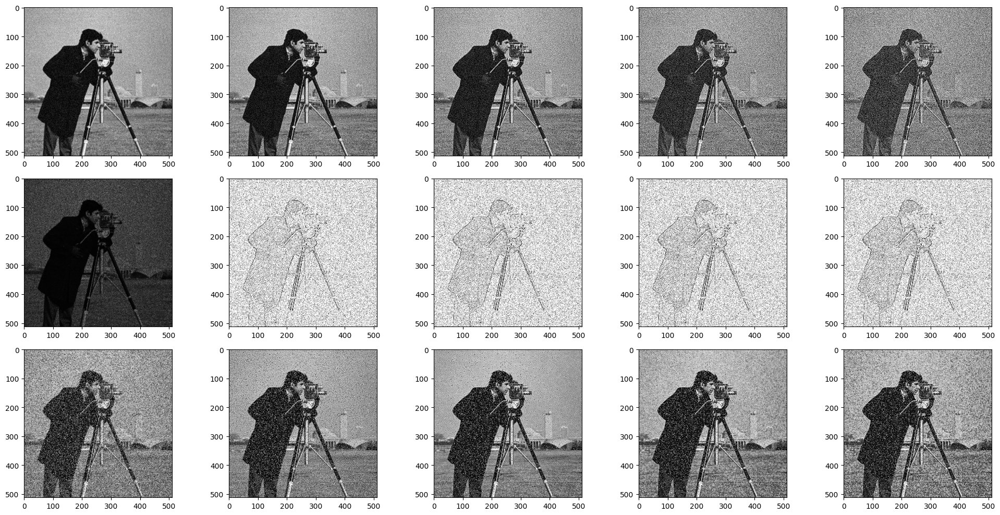

In [58]:
aplicacionesSucesivas = 4

imagenFilename = os.path.join("/content/Imagenes", 'cameraman.jpg')
imagenPrueba = io.imread(imagenFilename, as_gray=True)

# Agregamos ruido Gausseano Aditivo
ImagenConRuidoGausseano = util.random_noise(imagenPrueba, mode='gaussian', mean=0, var=0.01)
#Agregamos ruido Rayleigh Multiplicativo
imagenConRayleigh =  imagenPrueba * np.random.rayleigh(0.2, imagenPrueba.shape)
# Agregamos ruido Gausseano Aditivo
ImagenConSaltAndPepper = util.random_noise(imagenPrueba, mode='s&p', amount=0.3)

fig, axes = plt.subplots(3, aplicacionesSucesivas + 1, figsize=(20, 10))

axes[0][0].imshow(ImagenConRuidoGausseano, cmap=plt.cm.gray)
imagenAAplicar = ImagenConRuidoGausseano
for i in range(aplicacionesSucesivas):
  imagenSharp = SharpImage(imagenAAplicar)
  axes[0][i+1].imshow(imagenSharp, cmap=plt.cm.gray)
  imagenAAplicar = imagenSharp

axes[1][0].imshow(imagenConRayleigh, cmap=plt.cm.gray)
imagenAAplicar = imagenConRayleigh
for i in range(aplicacionesSucesivas):
  imagenSharp = SharpImage(imagenAAplicar)
  axes[1][i+1].imshow(imagenSharp, cmap=plt.cm.gray)
  imagenAAplicar = imagenSharp

axes[2][0].imshow(ImagenConSaltAndPepper, cmap=plt.cm.gray)
imagenAAplicar = ImagenConSaltAndPepper
for i in range(aplicacionesSucesivas):
  imagenSharp = SharpImage(imagenAAplicar)
  axes[2][i+1].imshow(imagenSharp, cmap=plt.cm.gray)
  imagenAAplicar = imagenSharp

fig.tight_layout()
plt.show()


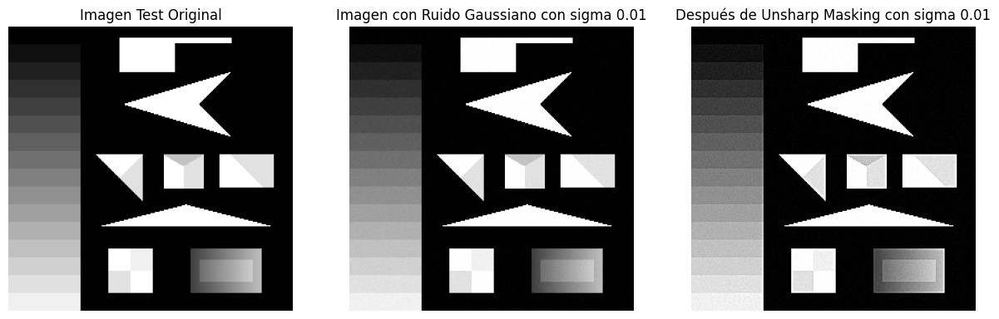

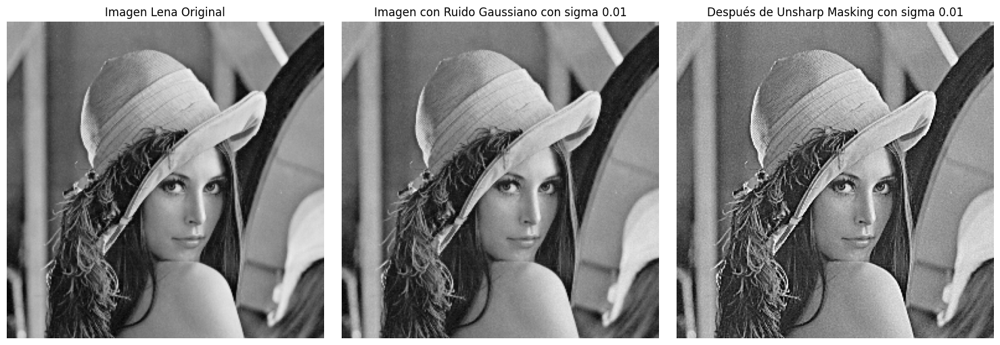

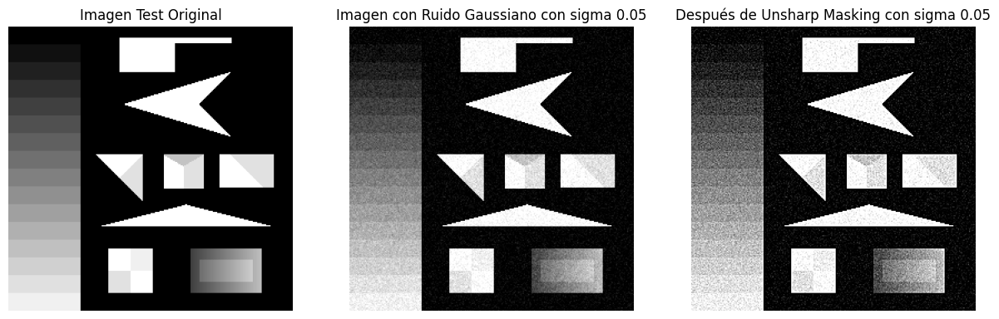

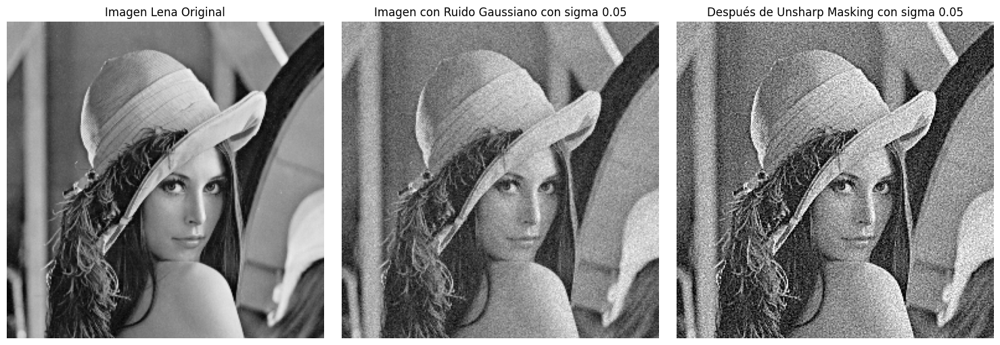

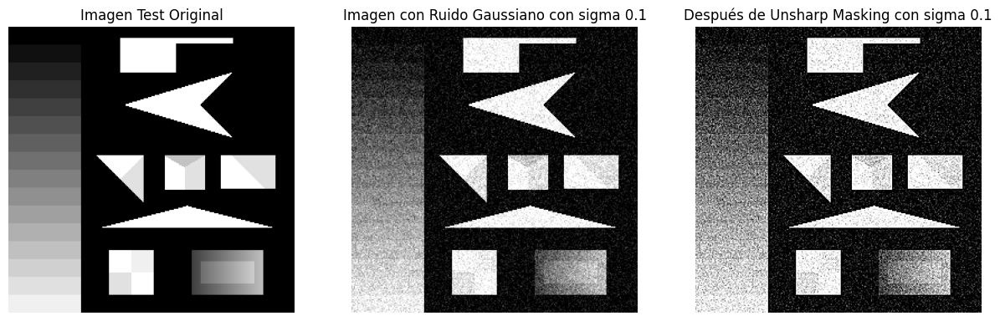

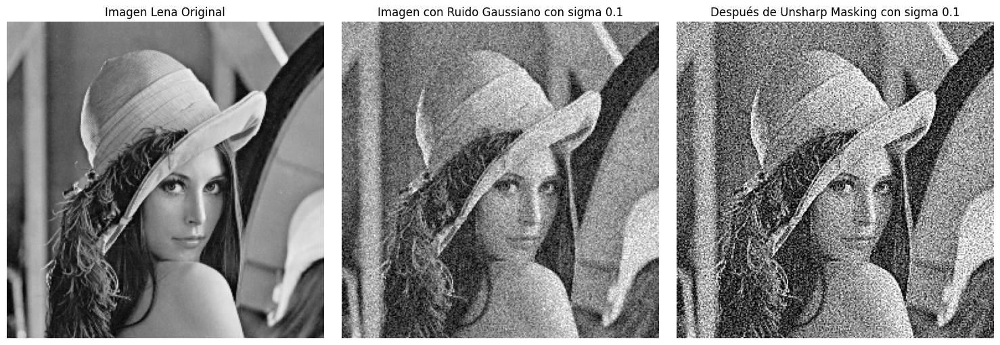

In [80]:
imagen_test = io.imread(os.path.join('/content/Imagenes', 'test.png'), as_gray=True)
imagen_lena = io.imread(os.path.join('/content/Imagenes', 'lena_gray_256.tif'), as_gray=True)

# Aplicamos Unsharp Masking
imagen_test_sharp = SharpImage(imagen_test)
imagen_lena_sharp = SharpImage(imagen_lena)

sigma_values = [0.01, 0.05, 0.1]

for sigma in sigma_values:
    varianza = sigma ** 2
    #Ruido Gaussiano
    imagen_test_ruido_gauss = util.random_noise(imagen_test, mode='gaussian', mean=0, var=varianza)
    imagen_lena_ruido_gauss = util.random_noise(imagen_lena, mode='gaussian', mean=0, var=varianza)

    #Unsharp Masking
    imagen_test_sharp_ruido_gauss = SharpImage(imagen_test_ruido_gauss)
    imagen_lena_sharp_ruido_gauss = SharpImage(imagen_lena_ruido_gauss)

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))


    axes[0].imshow(imagen_test, cmap='gray')
    axes[0].set_title('Imagen Test Original')
    axes[0].axis('off')


    axes[1].imshow(imagen_test_ruido_gauss, cmap='gray')
    axes[1].set_title(f'Imagen con Ruido Gaussiano con sigma {sigma}')
    axes[1].axis('off')


    axes[2].imshow(imagen_test_sharp_ruido_gauss, cmap='gray')
    axes[2].set_title(f'Después de Unsharp Masking con sigma {sigma}')
    axes[2].axis('off')
    plt.show()

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))


    axes[0].imshow(imagen_lena, cmap='gray')
    axes[0].set_title('Imagen Lena Original')
    axes[0].axis('off')


    axes[1].imshow(imagen_lena_ruido_gauss, cmap='gray')
    axes[1].set_title(f'Imagen con Ruido Gaussiano con sigma {sigma}')
    axes[1].axis('off')


    axes[2].imshow(imagen_lena_sharp_ruido_gauss, cmap='gray')
    axes[2].set_title(f'Después de Unsharp Masking con sigma {sigma}')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

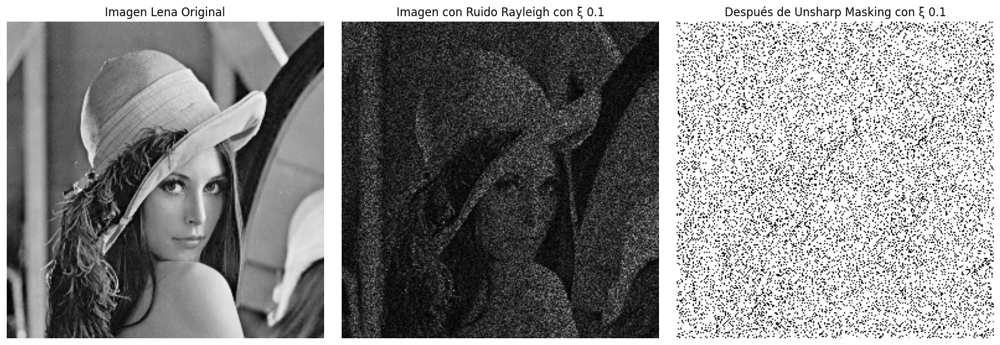

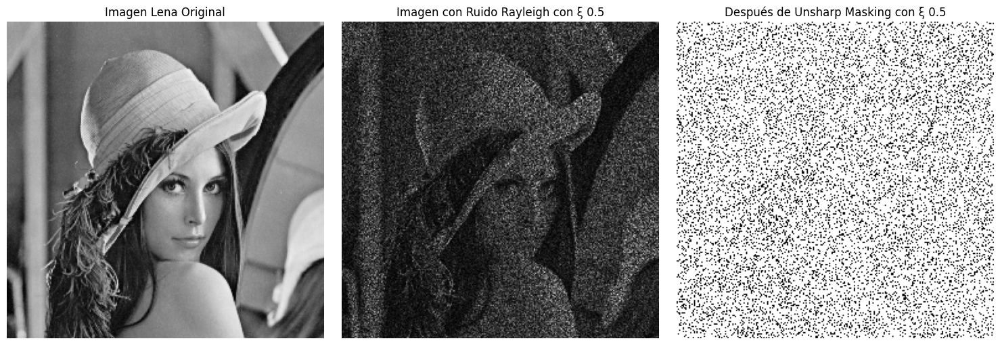

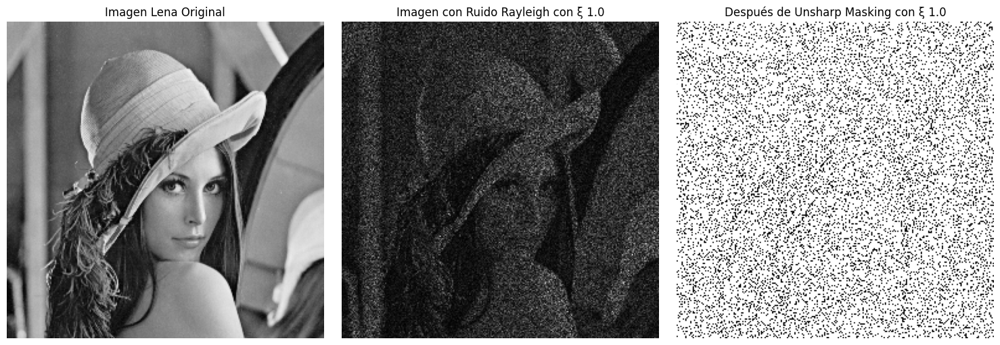

In [60]:
xi_values = [0.1, 0.5, 1.0]

for xi in xi_values:
    #Ruido Rayleigh
    ruido_rayleigh = np.random.rayleigh(scale=xi, size=imagen_test.shape)


    imagen_test_ruido_rayleigh = imagen_test * ruido_rayleigh
    imagen_lena_ruido_rayleigh = imagen_lena * ruido_rayleigh


    #Unsharp Masking
    imagen_test_sharp_ruido_rayleigh = SharpImage(imagen_test_ruido_rayleigh)
    imagen_lena_sharp_ruido_rayleigh = SharpImage(imagen_lena_ruido_rayleigh)

    axes[0].imshow(imagen_test, cmap='gray')
    axes[0].set_title('Imagen Test Original')
    axes[0].axis('off')


    axes[1].imshow(imagen_test_ruido_rayleigh, cmap='gray')
    axes[1].set_title(f'Imagen con Ruido Rayleigh con ξ {xi}')
    axes[1].axis('off')


    axes[2].imshow(imagen_test_sharp_ruido_rayleigh, cmap='gray')
    axes[2].set_title(f'Después de Unsharp Masking con ξ {xi}')
    axes[2].axis('off')
    plt.show()

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))


    axes[0].imshow(imagen_lena, cmap='gray')
    axes[0].set_title('Imagen Lena Original')
    axes[0].axis('off')


    axes[1].imshow(imagen_lena_ruido_rayleigh, cmap='gray')
    axes[1].set_title(f'Imagen con Ruido Rayleigh con ξ {xi}')
    axes[1].axis('off')


    axes[2].imshow(imagen_lena_sharp_ruido_rayleigh, cmap='gray')
    axes[2].set_title(f'Después de Unsharp Masking con ξ {xi}')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

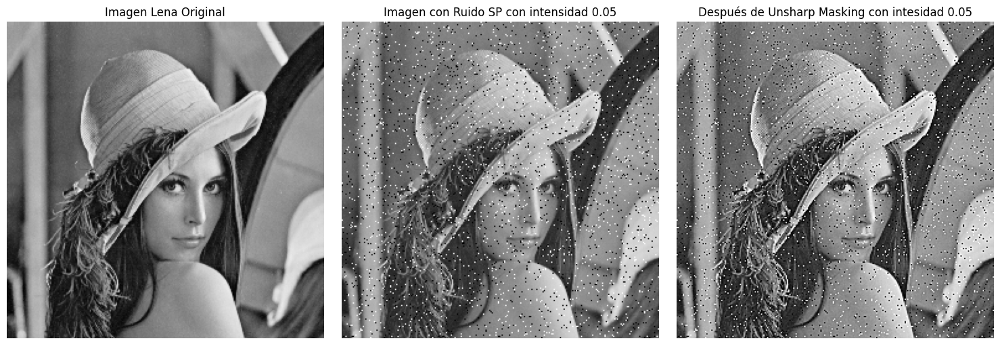

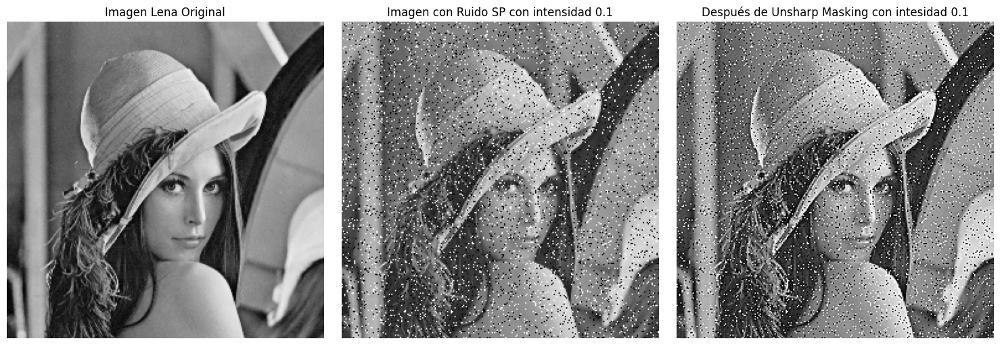

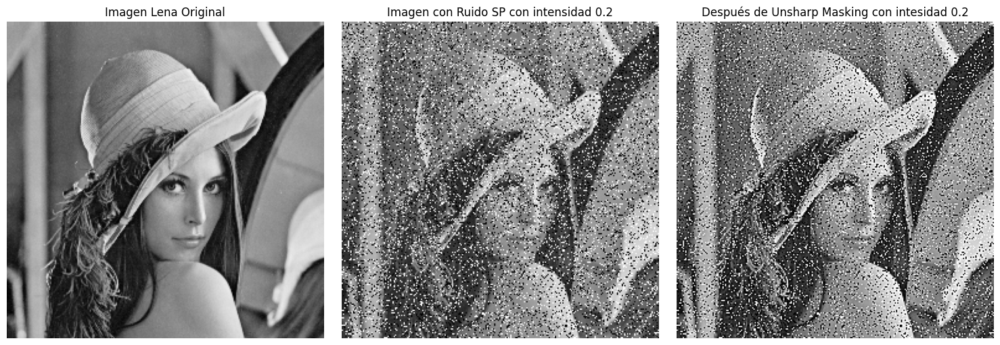

In [61]:
  #Valores de intensidad de ruido
amount_values = [0.05, 0.1, 0.2]

for amount in amount_values:
    #Ruido Salt & Pepper
    imagen_test_ruido_sp = util.random_noise(imagen_test, mode='s&p', amount=amount)
    imagen_lena_ruido_sp = util.random_noise(imagen_lena, mode='s&p', amount=amount)

    #Unsharp Masking
    imagen_test_sharp_ruido_sp = SharpImage(imagen_test_ruido_sp)
    imagen_lena_sharp_ruido_sp = SharpImage(imagen_lena_ruido_sp)

    axes[0].imshow(imagen_test, cmap='gray')
    axes[0].set_title('Imagen Test Original')
    axes[0].axis('off')


    axes[1].imshow(imagen_test_ruido_sp, cmap='gray')
    axes[1].set_title(f'Imagen con Ruido SP con intensidad {amount}')
    axes[1].axis('off')


    axes[2].imshow(imagen_test_sharp_ruido_sp, cmap='gray')
    axes[2].set_title(f'Después de Unsharp Masking con intensidad {amount}')
    axes[2].axis('off')
    plt.show()

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    axes[0].imshow(imagen_lena, cmap='gray')
    axes[0].set_title('Imagen Lena Original')
    axes[0].axis('off')


    axes[1].imshow(imagen_lena_ruido_sp, cmap='gray')
    axes[1].set_title(f'Imagen con Ruido SP con intensidad {amount}')
    axes[1].axis('off')


    axes[2].imshow(imagen_lena_sharp_ruido_sp, cmap='gray')
    axes[2].set_title(f'Después de Unsharp Masking con intesidad {amount}')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

#### El parametro de desenfoque en nuestra función de Sharp Image es relativamente bajo, por lo tanto la diferencia al aplicarla es baja si el ruido no modifica mucho la imágen.
#### De todas formas, es posible ver que al aplicar la máscara se ve más contrastada la imágen (ejemplo Salt & Pepper)

# **Implementacion de Canny**

**Paper Original**: https://www.researchgate.net/publication/224377985_A_Computational_Approach_To_Edge_Detection

**Video Util**: https://www.youtube.com/watch?v=hUC1uoigH6s

Implemente el algoritmo de canny, explique cada una de sus partes y muestre los resultados de forma parecida a la muestra de resultados de un paper, pueden utlizar como referencia el codigo en este collab para mostrar sus resultados. Hagan un analisis cambiando los parametros del filtro Gausseano y comparando los resultados ¿que se esta perdiendo? ¿Por que?

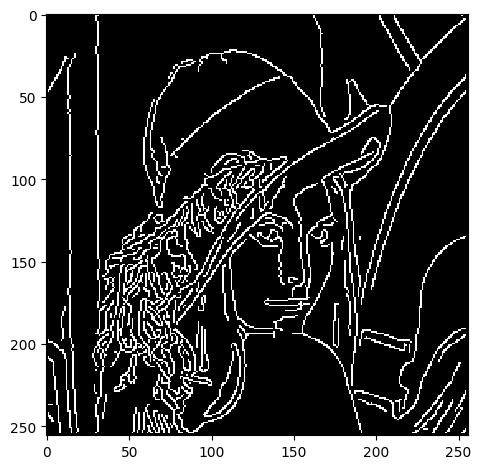

In [62]:
def canny(imagen, sigma = 0.1):
    # Escala de grises
    if len(imagen.shape) == 3:
        imagen = color.rgb2gray(imagen)

    # La suavizamos
    imagen_suavizada = filters.gaussian(imagen, sigma=1.0)

    # Adquirir el gradiante de la imagen y el angulo de borde
    gradientes = filters.sobel_h(imagen_suavizada), filters.sobel_v(imagen_suavizada)
    magnitud = np.hypot(gradientes[0], gradientes[1])
    angulo = np.arctan2(gradientes[1], gradientes[0]) * (180.0 / np.pi)

    # Truncar los ángulos de borde a 0, 45, 90 y 135 grados
    angulo[angulo < 0] += 180 # Las dimensiones de los ángulos son simétricas
    angulo_truncado = np.zeros_like(angulo)
    angulo_truncado[(angulo >= 0) & (angulo < 22.5)] = 0
    angulo_truncado[(angulo >= 22.5) & (angulo < 67.5)] = 45
    angulo_truncado[(angulo >= 67.5) & (angulo < 112.5)] = 90
    angulo_truncado[(angulo >= 112.5) & (angulo < 157.5)] = 135
    angulo_truncado[(angulo >= 157.5)] = 0

    # Aplicar la eliminación de no máximos
    maxima = np.zeros_like(magnitud)
    for i in range(1, magnitud.shape[0] - 1):
        for j in range(1, magnitud.shape[1] - 1):
            if angulo_truncado[i, j] == 0:
                if (magnitud[i, j] > magnitud[i, j-1] and magnitud[i, j] > magnitud[i, j+1]):
                    maxima[i, j] = magnitud[i, j]
            elif angulo_truncado[i, j] == 45:
                if (magnitud[i, j] > magnitud[i-1, j+1] and magnitud[i, j] > magnitud[i+1, j-1]):
                    maxima[i, j] = magnitud[i, j]
            elif angulo_truncado[i, j] == 90:
                if (magnitud[i, j] > magnitud[i-1, j] and magnitud[i, j] > magnitud[i+1, j]):
                    maxima[i, j] = magnitud[i, j]
            elif angulo_truncado[i, j] == 135:
                if (magnitud[i, j] > magnitud[i-1, j-1] and magnitud[i, j] > magnitud[i+1, j+1]):
                    maxima[i, j] = magnitud[i, j]

    # Aplicar la histeresis para detectar los bordes finales
    bordes = feature.canny(imagen_suavizada, sigma=sigma, low_threshold=0.1, high_threshold=0.3)

    return bordes

bordes = canny(imagen_lena, 0.2)

# Mostrar el resultado
io.imshow(bordes)
io.show()

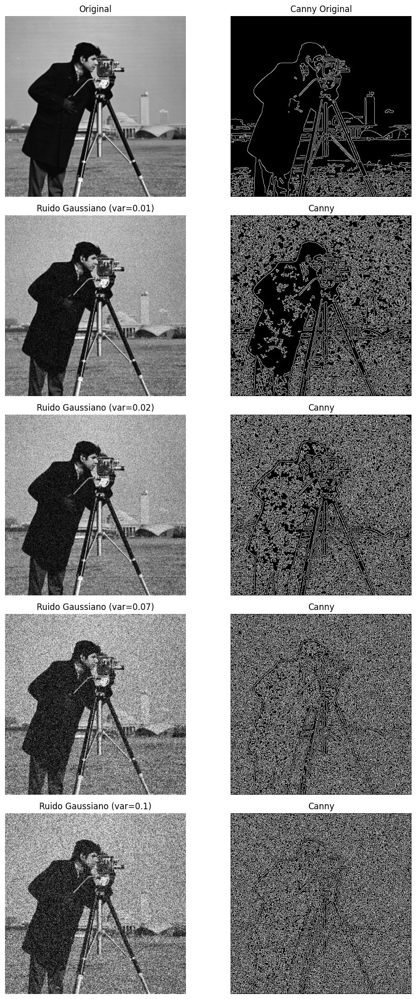

In [63]:
ruidos_sigma = [0.01, 0.02, 0.07, 0.1]
imagenes_ruidosas = [util.random_noise(imagenPrueba, mode='gaussian', mean=0, var=v) for v in ruidos_sigma]

fig, axs = plt.subplots(5, 2, figsize=(10, 20))

axs[0, 0].imshow(imagenPrueba, cmap='gray')
axs[0, 0].set_title('Original')
axs[0, 0].axis('off')

canny_original = canny(imagenPrueba)
axs[0, 1].imshow(canny_original, cmap='gray')
axs[0, 1].set_title('Canny Original')
axs[0, 1].axis('off')

for i in range(4):
    axs[i+1, 0].imshow(imagenes_ruidosas[i], cmap='gray')
    axs[i+1, 0].set_title(f'Ruido Gaussiano (var={ruidos_sigma[i]})')
    axs[i+1, 0].axis('off')

    canny_ruido = canny(imagenes_ruidosas[i])
    axs[i+1, 1].imshow(canny_ruido, cmap='gray')
    axs[i+1, 1].set_title(f'Canny')
    axs[i+1, 1].axis('off')

plt.tight_layout()
plt.show()

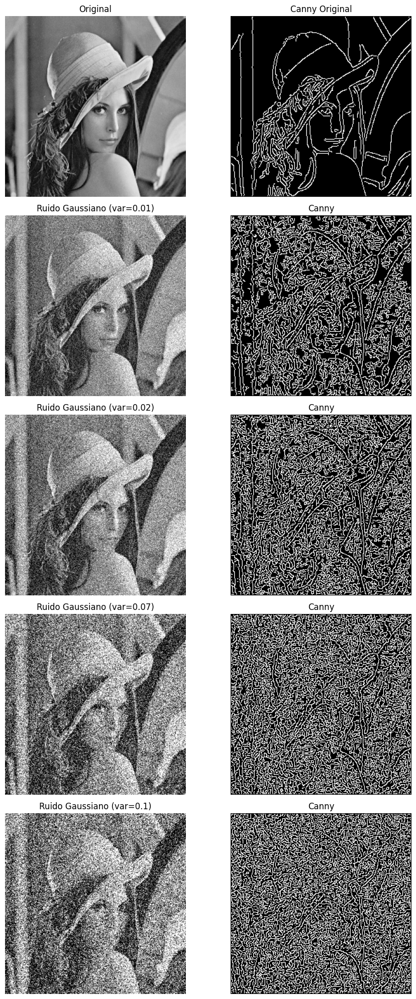

In [64]:
imagenes_ruidosas = [util.random_noise(imagen_lena, mode='gaussian', mean=0, var=v) for v in ruidos_sigma]

fig, axs = plt.subplots(5, 2, figsize=(10, 20))

axs[0, 0].imshow(imagen_lena, cmap='gray')
axs[0, 0].set_title('Original')
axs[0, 0].axis('off')

canny_original = canny(imagen_lena)
axs[0, 1].imshow(canny_original, cmap='gray')
axs[0, 1].set_title('Canny Original')
axs[0, 1].axis('off')

for i in range(4):
    axs[i+1, 0].imshow(imagenes_ruidosas[i], cmap='gray')
    axs[i+1, 0].set_title(f'Ruido Gaussiano (var={ruidos_sigma[i]})')
    axs[i+1, 0].axis('off')

    canny_ruido = canny(imagenes_ruidosas[i])
    axs[i+1, 1].imshow(canny_ruido, cmap='gray')
    axs[i+1, 1].set_title(f'Canny')
    axs[i+1, 1].axis('off')

plt.tight_layout()
plt.show()

# Ruido Gaussiano

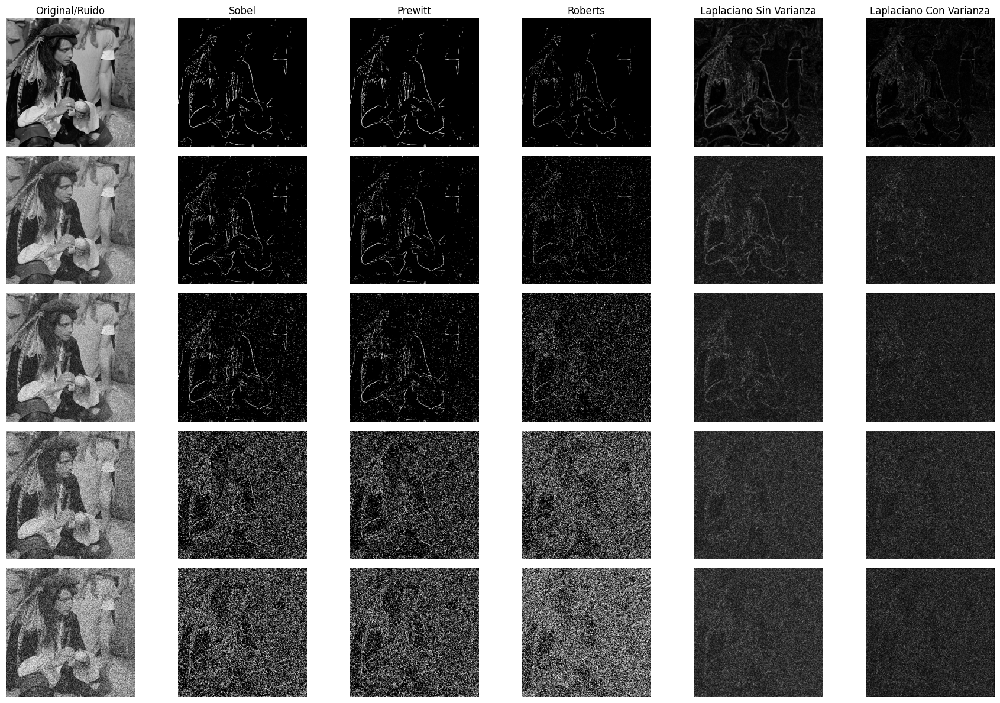

In [81]:
ruidos_sigma = [0.01, 0.02, 0.07, 0.1]
imagenes_ruidosas = [util.random_noise(imagenPrueba, mode='gaussian', mean=0, var=v) for v in ruidos_sigma]

fig, axs = plt.subplots(len(imagenes_ruidosas) + 1, 6, figsize=(18, 12))

thresholdBorde = 100
umbralVar = 0.000001  # Parámetro para Laplaciano con varianza local

titulos_metodos = ['Original/Ruido', 'Sobel', 'Prewitt', 'Roberts', 'Laplaciano Sin Varianza', 'Laplaciano Con Varianza']

metodos = [Sobel, Prewitt, Roberts, LaplacianoSinVarianzaLocal, LaplacianoConVarianzaLocal]

def aplicar_metodos_y_plotear(axs, fila, imagen, es_ruidosa=False, var=0):
    axs[fila, 0].imshow(imagen, cmap='gray')
    axs[fila, 0].axis('off')
    if fila == 0:
        axs[fila, 0].set_title(titulos_metodos[0])

    # Aplicar y mostrar los métodos de detección de bordes
    for col, metodo in enumerate(metodos):
        if col < 3:  # Para Sobel, Prewitt y Roberts que usan thresholdBorde
            resultado = metodo(imagen, thresholdBorde)
        else:  # Para Laplaciano sin y con varianza
            resultado = metodo(imagen, umbralVar) if metodo == LaplacianoConVarianzaLocal else metodo(imagen)

        axs[fila, col+1].imshow(resultado, cmap='gray')
        if fila == 0:
            axs[fila, col+1].set_title(titulos_metodos[col+1])
        axs[fila, col+1].axis('off')

    # Etiqueta
    pie_imagen = 'Imagen Original' if not es_ruidosa else f'Ruido (var={var})'
    axs[fila, 0].set_ylabel(pie_imagen, rotation=90, size='large')

aplicar_metodos_y_plotear(axs, 0, imagenPrueba)

for i, (imagen_ruidosa, var) in enumerate(zip(imagenes_ruidosas, ruidos_sigma), start=1):
    aplicar_metodos_y_plotear(axs, i, imagen_ruidosa, es_ruidosa=True, var=var)

plt.tight_layout()
plt.show()

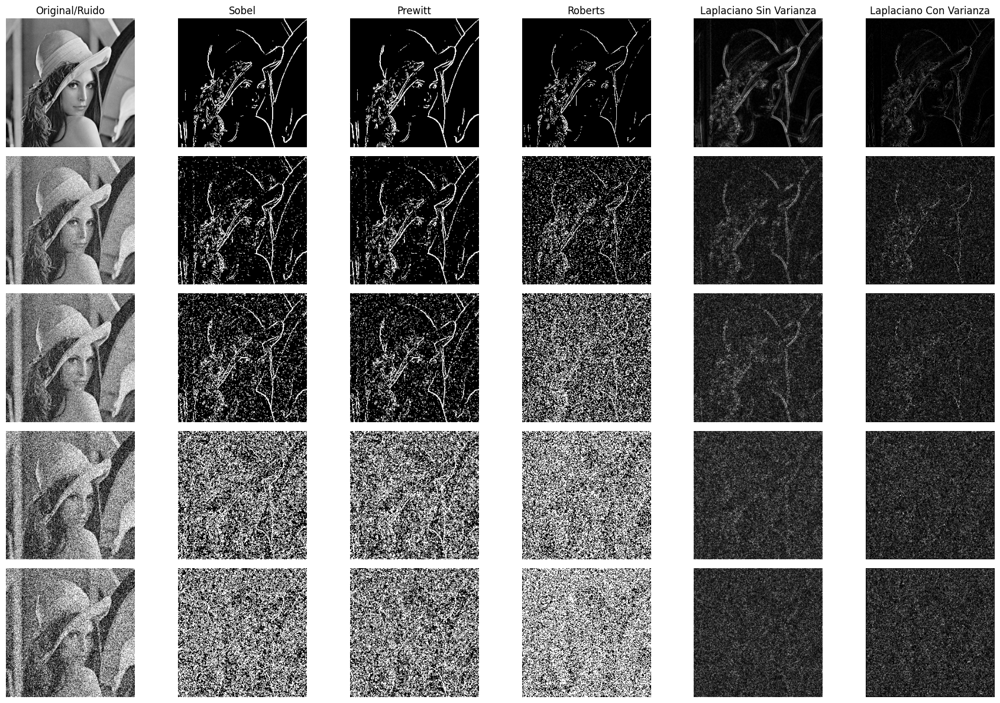

In [83]:
ruidos_sigma = [0.01, 0.02, 0.07, 0.1]
imagenes_ruidosas = [util.random_noise(imagen_lena, mode='gaussian', mean=0, var=v) for v in ruidos_sigma]

fig, axs = plt.subplots(len(imagenes_ruidosas) + 1, 6, figsize=(18, 12))

thresholdBorde = 70
umbralVar = 0.000001  # Parámetro para Laplaciano con varianza local


titulos_metodos = ['Original/Ruido', 'Sobel', 'Prewitt', 'Roberts', 'Laplaciano Sin Varianza', 'Laplaciano Con Varianza']

metodos = [Sobel, Prewitt, Roberts, LaplacianoSinVarianzaLocal, LaplacianoConVarianzaLocal]

def aplicar_metodos_y_plotear(axs, fila, imagen, es_ruidosa=False, var=0):
    axs[fila, 0].imshow(imagen, cmap='gray')
    axs[fila, 0].axis('off')
    if fila == 0:
        axs[fila, 0].set_title(titulos_metodos[0])

    for col, metodo in enumerate(metodos):
        if col < 3:  # Para Sobel, Prewitt y Roberts que usan thresholdBorde
            resultado = metodo(imagen, thresholdBorde)
        else:  # Para Laplaciano sin y con varianza
            resultado = metodo(imagen, umbralVar) if metodo == LaplacianoConVarianzaLocal else metodo(imagen)

        axs[fila, col+1].imshow(resultado, cmap='gray')
        if fila == 0:
            axs[fila, col+1].set_title(titulos_metodos[col+1])
        axs[fila, col+1].axis('off')

    # Etiqueta
    pie_imagen = 'Imagen Original' if not es_ruidosa else f'Ruido (var={var})'
    axs[fila, 0].set_ylabel(pie_imagen, rotation=90, size='large')

aplicar_metodos_y_plotear(axs, 0, imagen_lena)

for i, (imagen_ruidosa, var) in enumerate(zip(imagenes_ruidosas, ruidos_sigma), start=1):
    aplicar_metodos_y_plotear(axs, i, imagen_ruidosa, es_ruidosa=True, var=var)

plt.tight_layout()
plt.show()

#Ruido Rayleigh

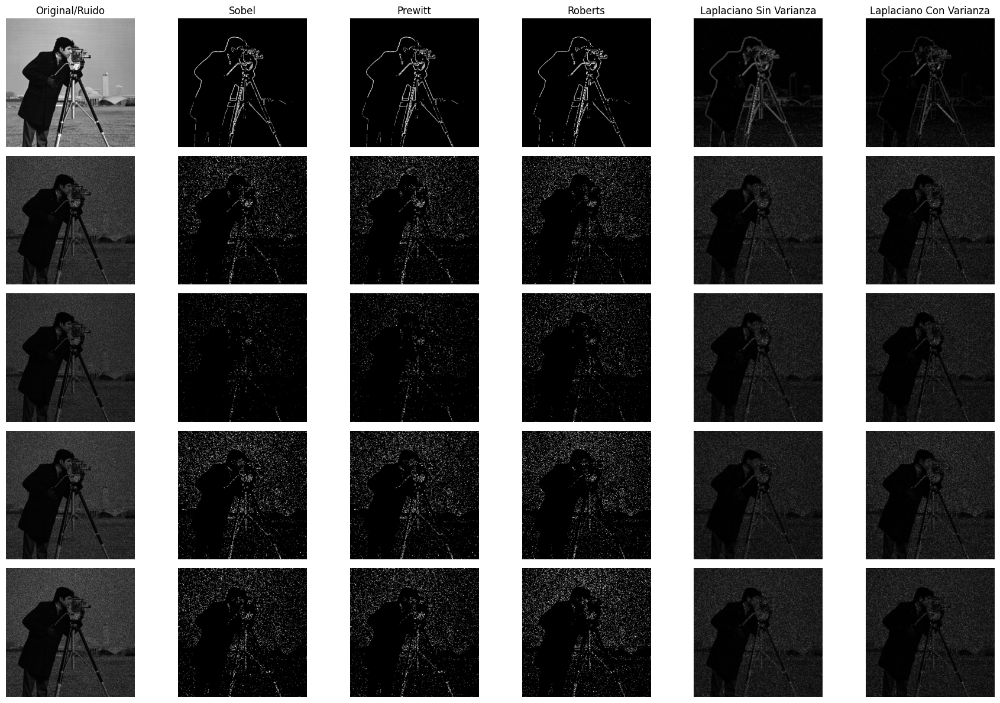

In [67]:
ruidos_sigma = [0.01, 0.02, 0.07, 0.1]
imagenes_ruidosas = [imagenPrueba * np.random.rayleigh(0.2, imagenPrueba.shape) for v in ruidos_sigma]

fig, axs = plt.subplots(len(imagenes_ruidosas) + 1, 6, figsize=(18, 12))

thresholdBorde = 100
umbralVar = 0.000001  # Parámetro para Laplaciano con varianza local


titulos_metodos = ['Original/Ruido', 'Sobel', 'Prewitt', 'Roberts', 'Laplaciano Sin Varianza', 'Laplaciano Con Varianza']

metodos = [Sobel, Prewitt, Roberts, LaplacianoSinVarianzaLocal, LaplacianoConVarianzaLocal]

def aplicar_metodos_y_plotear(axs, fila, imagen, es_ruidosa=False, var=0):
    axs[fila, 0].imshow(imagen, cmap='gray')
    axs[fila, 0].axis('off')
    if fila == 0:
        axs[fila, 0].set_title(titulos_metodos[0])

    # Aplicar y mostrar los métodos de detección de bordes
    for col, metodo in enumerate(metodos):
        if col < 3:  # Para Sobel, Prewitt y Roberts que usan thresholdBorde
            resultado = metodo(imagen, thresholdBorde)
        else:  # Para Laplaciano sin y con varianza
            resultado = metodo(imagen, umbralVar) if metodo == LaplacianoConVarianzaLocal else metodo(imagen)

        axs[fila, col+1].imshow(resultado, cmap='gray')
        if fila == 0:
            axs[fila, col+1].set_title(titulos_metodos[col+1])
        axs[fila, col+1].axis('off')

    # Etiqueta
    pie_imagen = 'Imagen Original' if not es_ruidosa else f'Ruido (var={var})'
    axs[fila, 0].set_ylabel(pie_imagen, rotation=90, size='large')

aplicar_metodos_y_plotear(axs, 0, imagenPrueba)

for i, (imagen_ruidosa, var) in enumerate(zip(imagenes_ruidosas, ruidos_sigma), start=1):
    aplicar_metodos_y_plotear(axs, i, imagen_ruidosa, es_ruidosa=True, var=var)

plt.tight_layout()
plt.show()

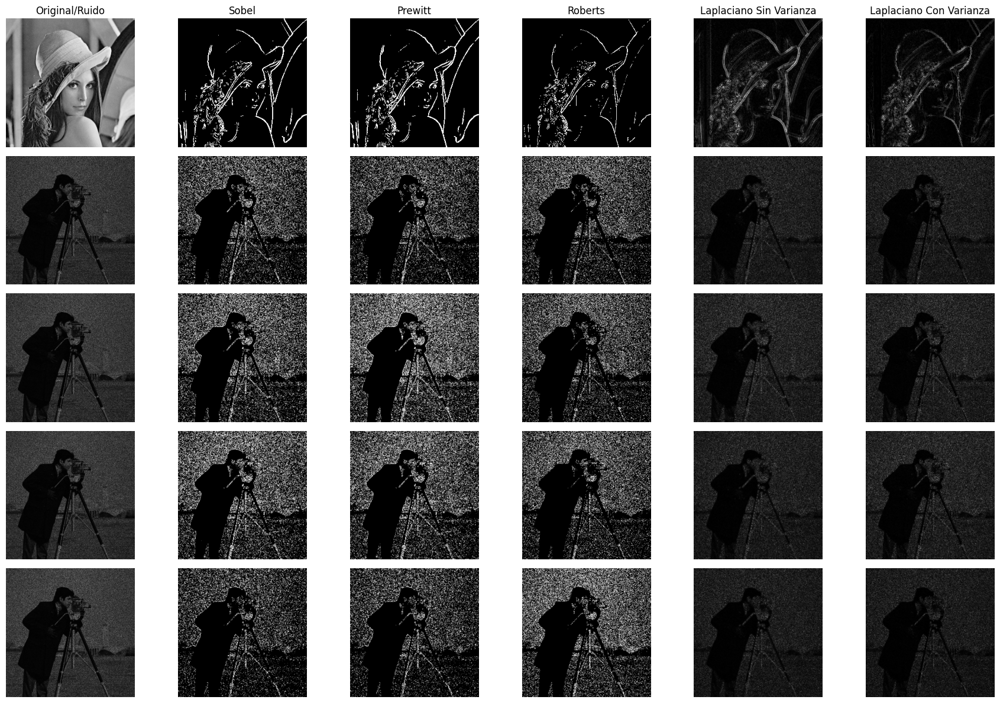

In [72]:
ruidos_sigma = [0.01, 0.02, 0.07, 0.1]
imagenes_ruidosas = [imagenPrueba * np.random.rayleigh(0.2, imagenPrueba.shape) for v in ruidos_sigma]
fig, axs = plt.subplots(len(imagenes_ruidosas) + 1, 6, figsize=(18, 12))

thresholdBorde = 70
umbralVar = 0.000001  # Parámetro para Laplaciano con varianza local


titulos_metodos = ['Original/Ruido', 'Sobel', 'Prewitt', 'Roberts', 'Laplaciano Sin Varianza', 'Laplaciano Con Varianza']

metodos = [Sobel, Prewitt, Roberts, LaplacianoSinVarianzaLocal, LaplacianoConVarianzaLocal]

def aplicar_metodos_y_plotear(axs, fila, imagen, es_ruidosa=False, var=0):
    axs[fila, 0].imshow(imagen, cmap='gray')
    axs[fila, 0].axis('off')
    if fila == 0:
        axs[fila, 0].set_title(titulos_metodos[0])

    for col, metodo in enumerate(metodos):
        if col < 3:  # Para Sobel, Prewitt y Roberts que usan thresholdBorde
            resultado = metodo(imagen, thresholdBorde)
        else:  # Para Laplaciano sin y con varianza
            resultado = metodo(imagen, umbralVar) if metodo == LaplacianoConVarianzaLocal else metodo(imagen)

        axs[fila, col+1].imshow(resultado, cmap='gray')
        if fila == 0:
            axs[fila, col+1].set_title(titulos_metodos[col+1])
        axs[fila, col+1].axis('off')

    # Etiqueta
    pie_imagen = 'Imagen Original' if not es_ruidosa else f'Ruido (var={var})'
    axs[fila, 0].set_ylabel(pie_imagen, rotation=90, size='large')

aplicar_metodos_y_plotear(axs, 0, imagen_lena)

for i, (imagen_ruidosa, var) in enumerate(zip(imagenes_ruidosas, ruidos_sigma), start=1):
    aplicar_metodos_y_plotear(axs, i, imagen_ruidosa, es_ruidosa=True, var=var)

plt.tight_layout()
plt.show()